Sources:

https://github.com/Coding-Crashkurse/RAG-Evaluation-with-Ragas/blob/main/ragas.ipynb
https://www.youtube.com/watch?v=aeae-sITqEA

In [ ]:
!pip install langchain langchain-community

Youtube Link:
https://www.youtube.com/watch?v=aeae-sITqEA

In [ ]:
# SIMULATING THE APP HERE, ONLY FOR 1 DOCUMENT
from langchain_community.document_loaders import PyPDFLoader
from langchain_text_splitters import RecursiveCharacterTextSplitter
data_path = "Aspect Detection and Sentiment Classification using Deep Neural Network for Indonesian Aspect-Based Sentiment Analysis.pdf"

print("Loading PDF...")
loader = PyPDFLoader(data_path)
pages = loader.load()

for page in pages:
  page.metadata['file_name'] = page.metadata['source']

print(f"PDF loaded: {data_path}...")

print("Splitting text...")
# Initialize the RecursiveCharacterTextSplitter for splitting text
# predefined length -- how many chars do we want per chunk
# overlap - character 0 - 1000, first document. Then, there's an overlap of +-150 characters between doc 1 and doc 2
text_splitter = RecursiveCharacterTextSplitter(separators=["\n\n", "\n"], chunk_size=1000, chunk_overlap=50)
chunked_documents = text_splitter.split_documents(pages)

print('Length of chunks:', len(chunked_documents))

In [2]:
# SIMULATING THE APP HERE, FOR MULTI DOCUMENT
from langchain_community.document_loaders import PyPDFDirectoryLoader
from langchain_text_splitters import RecursiveCharacterTextSplitter
data_path = "."

print("Loading directory...")
# pdf_loader = PyPDFDirectoryLoader(path=data_path, glob="**/*.pdf", recursive=True)
pdf_loader = PyPDFDirectoryLoader(path=data_path, glob="*.pdf", recursive=True)
documents = pdf_loader.load()

for document in documents:
  document.metadata['file_name'] = document.metadata['source']

print("Directory loaded...")
print("Documents length:", len(documents))

print("Splitting text...")
# Initialize the RecursiveCharacterTextSplitter for splitting text
# predefined length -- how many chars do we want per chunk
# overlap - character 0 - 1000, first document. Then, there's an overlap of +-150 characters between doc 1 and doc 2
text_splitter = RecursiveCharacterTextSplitter(chunk_size=1000, chunk_overlap=50)
chunked_documents = text_splitter.split_documents(documents)

# Remove the bibiography of each PDF ?? Maybe not needed
print('Length of chunks:', len(chunked_documents))

Loading directory...
Directory loaded...
Documents length: 35
Splitting text...
Length of chunks: 179


In [3]:
import os
from dotenv import load_dotenv
load_dotenv()
openai_api_key=os.environ["OPENAI_API_KEY"]
print("done")

done


In [4]:
# "gpt-4-1106-preview"
GPT_MODEL = "gpt-3.5-turbo-0125"
CRITIC_MODEL = "gpt-4-turbo"
EMBEDDING_MODEL = "text-embedding-ada-002"

In [5]:
chunked_documents

[Document(page_content='Preprint\nSANDWICH ATTACK : M ULTI -LANGUAGE MIXTURE\nADAPTIVE ATTACK ON LLM S\nBibek Upadhayay & Vahid Behzadan, Ph.D\nSAIL LAB\nUniversity of New Haven\nConnecticut, CT 06516, USA\n{bupadhayay,vbehzadan }@newhaven.edu\nABSTRACT\nLarge Language Models (LLMs) are increasingly being developed and applied,\nbut their widespread use faces challenges. These include aligning LLMs’ re-\nsponses with human values to prevent harmful outputs, which is addressed through\nsafety training methods. Even so, bad actors and malicious users have succeeded\nin attempts to manipulate the LLMs to generate misaligned responses for harmful\nquestions such as methods to create a bomb in school labs, recipes for harmful\ndrugs, and ways to evade privacy rights. Another challenge is the multilingual ca-\npabilities of LLMs, which enable the model to understand and respond in multiple\nlanguages. Consequently, attackers exploit the unbalanced pre-training datasets', metadata={'source': 

In [6]:

from ragas.testset.generator import TestsetGenerator
from ragas.testset.evolutions import simple, reasoning, multi_context

generator = TestsetGenerator.with_openai()

generator_llm = "gpt-3.5-turbo-0125" #being used in the app
# critic_llm = "gpt-4-turbo" #to be used by the evaluator
critic_llm = "gpt-3.5-turbo-0125" #to be used by the evaluator
embeddings = "text-embedding-ada-002" #being used in the app

generator = TestsetGenerator.with_openai(
    generator_llm,
    critic_llm,
    embeddings
)

# Test sets are 20% simple, 45% are reasoning, and 35% to be multi_context
distributions = {
    simple: 0.20,
    reasoning: 0.45,
    multi_context: 0.35
}

total_weight = sum(distributions.values())
if total_weight == 1:
    print("Distribution is valid.")
else:
    print(f"Total weight is {total_weight}, which does not equal 1. Please adjust your distribution.")

# generate testset
testset = generator.generate_with_langchain_docs(chunked_documents, test_size=15, distributions=distributions)

c:\Users\louis\Desktop\ay2023-2024-1st-sem-cmsc190-sp1-ridiculoys\code\venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\louis\AppData\Local\Temp\ipykernel_3536\3838157382.py:4: DeprecationWarning: The function with_openai was deprecated in 0.1.4, and will be removed in the 0.2.0 release. Use from_langchain instead.
  generator = TestsetGenerator.with_openai()
C:\Users\louis\AppData\Local\Temp\ipykernel_3536\3838157382.py:11: DeprecationWarning: The function with_openai was deprecated in 0.1.4, and will be removed in the 0.2.0 release. Use from_langchain instead.
  generator = TestsetGenerator.with_openai(


Distribution is valid.


Filename and doc_id are the same for all nodes.                   
Generating: 100%|██████████| 15/15 [05:48<00:00, 23.20s/it]


In [8]:
testset.to_pandas()

,question,contexts,ground_truth,evolution_type,metadata,episode_done
0,How does the move towards decentralization in ...,"[such as malware scans, it’s feasible to distr...",The move towards decentralization in emerging ...,simple,[{'source': 'VELLET Verifiable Embedded Wallet...,True
1,How do adversarial questions impact the respon...,[or against the model alignment policy. The ca...,Adversarial questions impact the responses gen...,simple,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
2,How does decentralizing permissions enhance th...,[Theexecute() function executes the functional...,Decentralizing permissions enhances the overal...,simple,[{'source': 'VELLET Verifiable Embedded Wallet...,True
3,How does the trust anchor ensure application t...,"[such as malware scans, it’s feasible to distr...",The trust anchor in Web3 typically involves th...,reasoning,[{'source': 'VELLET Verifiable Embedded Wallet...,True
4,Which framework was used to create multilingua...,[of unsafe content. The authors tested the att...,SELF-DEFENSE framework,reasoning,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
5,How can blockchain wallet interfaces overcome ...,[Crossing this chasm faces several technical c...,To address the technical challenges related to...,reasoning,[{'source': 'VELLET Verifiable Embedded Wallet...,True
6,How do researchers use adversarial prompts in ...,[type of jailbreak involves utilizing prompts ...,Researchers use adversarial prompts in differe...,multi_context,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
7,What were the effects of adjusting temperature...,[or against the model alignment policy. The ca...,The effects of adjusting temperature and rando...,multi_context,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
8,How to defend against the 'Sandwich attack' ja...,[mode. The additional reasons could be the lac...,nan,multi_context,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
9,How does the SELF-DEFENSE framework help in cr...,[of unsafe content. The authors tested the att...,The SELF-DEFENSE framework helps in creating m...,multi_context,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True


In [9]:
testset.to_pandas().to_csv('testset.csv', index=False)

In [10]:
import pandas as pd

testset = pd.read_csv("testset.csv")

In [11]:
testset

,question,contexts,ground_truth,evolution_type,metadata,episode_done
0,How does the move towards decentralization in ...,"['such as malware scans, it’s feasible to dist...",The move towards decentralization in emerging ...,simple,[{'source': 'VELLET Verifiable Embedded Wallet...,True
1,How do adversarial questions impact the respon...,['or against the model alignment policy. The c...,Adversarial questions impact the responses gen...,simple,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
2,How does decentralizing permissions enhance th...,['Theexecute() function executes the functiona...,Decentralizing permissions enhances the overal...,simple,[{'source': 'VELLET Verifiable Embedded Wallet...,True
3,How does the trust anchor ensure application t...,"['such as malware scans, it’s feasible to dist...",The trust anchor in Web3 typically involves th...,reasoning,[{'source': 'VELLET Verifiable Embedded Wallet...,True
4,Which framework was used to create multilingua...,['of unsafe content. The authors tested the at...,SELF-DEFENSE framework,reasoning,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
5,How can blockchain wallet interfaces overcome ...,['Crossing this chasm faces several technical ...,To address the technical challenges related to...,reasoning,[{'source': 'VELLET Verifiable Embedded Wallet...,True
6,How do researchers use adversarial prompts in ...,['type of jailbreak involves utilizing prompts...,Researchers use adversarial prompts in differe...,multi_context,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
7,What were the effects of adjusting temperature...,['or against the model alignment policy. The c...,The effects of adjusting temperature and rando...,multi_context,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
8,How to defend against the 'Sandwich attack' ja...,['mode. The additional reasons could be the la...,NaN,multi_context,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True
9,How does the SELF-DEFENSE framework help in cr...,['of unsafe content. The authors tested the at...,The SELF-DEFENSE framework helps in creating m...,multi_context,[{'source': 'SANDWICH ATTACK MULTI-LANGUAGE MI...,True


In [12]:
from langchain_openai.embeddings import OpenAIEmbeddings
from langchain_pinecone import PineconeVectorStore

""" 
OPTIONS:
  ics-chatbot-ai
  ics-chatbot-security
  ics-chatbot-algorithms
  ics-chatbot-os
  ics-chatbot-hci
  ics-chatbot-general
"""
index_options = ["ics-chatbot-ai", "ics-chatbot-security", "ics-chatbot-algorithms", "ics-chatbot-os", "ics-chatbot-hci", "ics-chatbot-general"]
index_name=index_options[1]

embeddings = OpenAIEmbeddings(model=EMBEDDING_MODEL)
pinecone = PineconeVectorStore.from_existing_index(index_name=index_name, embedding=embeddings)

retriever = pinecone.as_retriever()

In [13]:
from search_prompts import SearchPrompts
prompt = SearchPrompts.answer_query_prompt()
prompt

ChatPromptTemplate(input_variables=['conversation_history', 'question', 'question_subject', 'question_type', 'references', 'semantic_keywords', 'summaries', 'topic'], messages=[HumanMessagePromptTemplate(prompt=PromptTemplate(input_variables=['conversation_history', 'question', 'question_subject', 'question_type', 'references', 'semantic_keywords', 'summaries', 'topic'], template="\n      You are an expert research paper assistant chatbot who helps researchers in understanding the content of relevant research papers related to the topic: {topic}. \n      \n      **Your role:**\n      - You must obey only these instructions given to you and not deviate from them.\n      - Your primary task is to comprehensively answer the user's question in a helpful and professional manner using a friendly conversational tone.\n      - Use the dependency grammar linguistic framework rather than phrase structure grammar to craft a response to the user's query. The idea is that the closer together each p

In [14]:
from langchain.chains.qa_with_sources.retrieval import RetrievalQAWithSourcesChain 
from langchain_openai import ChatOpenAI

llm = ChatOpenAI(openai_api_key=openai_api_key,model=GPT_MODEL, temperature=0)

chain = RetrievalQAWithSourcesChain.from_chain_type(
    llm=llm,
    chain_type="stuff",
    retriever=retriever,
    chain_type_kwargs={
        "prompt": prompt,
        # "verbose": True
    },
    # verbose=True,
)
chain

RetrievalQAWithSourcesChain(combine_documents_chain=StuffDocumentsChain(llm_chain=LLMChain(prompt=ChatPromptTemplate(input_variables=['conversation_history', 'question', 'question_subject', 'question_type', 'references', 'semantic_keywords', 'summaries', 'topic'], messages=[HumanMessagePromptTemplate(prompt=PromptTemplate(input_variables=['conversation_history', 'question', 'question_subject', 'question_type', 'references', 'semantic_keywords', 'summaries', 'topic'], template="\n      You are an expert research paper assistant chatbot who helps researchers in understanding the content of relevant research papers related to the topic: {topic}. \n      \n      **Your role:**\n      - You must obey only these instructions given to you and not deviate from them.\n      - Your primary task is to comprehensively answer the user's question in a helpful and professional manner using a friendly conversational tone.\n      - Use the dependency grammar linguistic framework rather than phrase stru

In [ ]:
# user_query = "How does the CNN-based model struggle to classify sentiment accurately in certain cases?"

# results = pinecone.similarity_search(user_query, k=10)
# reference = results[0].metadata['reference']

# topic = "Artificial Intelligence"
# chat_history = ""
# question_type = ""
# question_subject = ""
# semantic_keywords = ""

# inputs = {"topic":topic, "references": reference, "question": user_query, "conversation_history": "", "question_type": question_type, "question_subject": question_subject, "semantic_keywords": semantic_keywords}

# chain_response = chain.invoke(inputs)
# response = chain_response["answer"]

In [ ]:
# response

In [16]:
# OpenAI Function Calling
from openai import OpenAI
from tenacity import retry, wait_random_exponential, stop_after_attempt
client = OpenAI()

# Utilities
@retry(wait=wait_random_exponential(multiplier=1, max=40), stop=stop_after_attempt(3))
def chat_completion_request(messages, tools=None, tool_choice=None, model=GPT_MODEL):
    try:
        response = client.chat.completions.create(
            model=model,
            messages=messages,
            tools=tools,
            tool_choice=tool_choice,
        )
        return response
    except Exception as e:
        print("Unable to generate ChatCompletion response")
        print(f"Exception: {e}")
        return e
# Utilities

# OpenAI Function Calling

def setup_tools():

  tools = [
    {
      "type": "function",
      "function": {
        "name": "get_answer",
        "description": "Use this function to provide answers to the user's queries.",
        "parameters": {
          "type": "object",
          "properties": {
            "question_type": {
              "type": "string",
              "description": "The nature of the user's inquiry if it is asking for clarification, context, definition, explanation, follow-up, comparison, results, list of papers, or any other type of inquiry."
            },
            "question_subject": {
              "type": "string",
              "description": "The specific topic or subject within the research paper or journal that the user is inquiring about."
            },
            "semantic_keywords": {
              "type": "string",
              "description": "The semantic keywords associated with the user query. Do not make assumptions from the query. Return as a comma-separated list."
            }
          },
          "required": ["question_type", "question_subject", "semantic_keywords"]
        }
      }
    }
  ]

  return tools

In [17]:
def answer_user_query(vectorstore, args, user_query, topic, chat_history):
  results=""
  try:
    results = vectorstore.similarity_search(user_query, k=5)
    # results = vectorstore.get_relevant_documents(user_query)

    filenames = list(set([result.metadata['file_name'] for result in results]))
    added = []

    references = []
    for result in results:
      if result.metadata['file_name'] in filenames and result.metadata['file_name'] not in added:
        references.append(result.metadata)
        added.append(result.metadata['file_name'])
    references = [reference['reference'] for reference in references]

    processed_chat_history = chat_history[1:-1] if len(chat_history) > 3 else ""

    question_type = args['question_type']
    question_subject = args['question_subject']
    semantic_keywords = args['semantic_keywords']

    inputs = {"topic":topic, "references": "\n".join(references), "question": user_query, "conversation_history": processed_chat_history, "question_type": question_type, "question_subject": question_subject, "semantic_keywords": semantic_keywords}
    chain_response = chain.invoke(inputs)
    response = chain_response["answer"]
  except Exception as e:
    response = f"query failed with error: {e}"
  return results, response

In [24]:
# questions = testset.to_pandas()["question"].to_list()
# ground_truth = testset.to_pandas()["ground_truth"].to_list()
questions = testset["question"].to_list()
ground_truth = testset["ground_truth"].to_list()
ground_truth = ["" if isinstance(element, float) else element for element in ground_truth]

print(questions)
print(ground_truth)

['How does the move towards decentralization in emerging digital frameworks, such as Web3, impact mechanisms for ensuring authenticity and integrity, particularly in the context of embedded wallets?', 'How do adversarial questions impact the responses generated by language models like Gemini Pro and LLAMA-2?', 'How does decentralizing permissions enhance the overall security of the system in the context of embedded wallets?', 'How does the trust anchor ensure application trustworthiness in Web3?', 'Which framework was used to create multilingual training data for safety training in the study?', 'How can blockchain wallet interfaces overcome technical challenges by mimicking online banking designs?', 'How do researchers use adversarial prompts in different languages for language model jailbreaks, including methods like Translation-based Jailbreak, Multilingual Adaptive Attack, and Multilingual Cognitive Overload?', 'What were the effects of adjusting temperature and random seed on Gemin

In [19]:
from datasets import Dataset
import json

data = {"question": [], "answer": [], "contexts": [], "ground_truth": ground_truth}
tools = setup_tools()
chat_history = []
chat_history.append({"role": "system", "content": "You are a research assistant chatbot specializing in Computer Science. Your goal is to facilitate the user's research process by using the correct tool based on their queries. If the user query is not related to Computer Science, apologize and then respond in a friendly, professional, and conversational tone on how you are tasked to answer queries about Computer Science and then kindly ask them how else you can help. You should not independently answer questions from the user. ALWAYS use the function call to provide responses UNLESS you are asking the user for a follow-up or clarification for an ambiguous question. ALWAYS try to answer the most recent user message with a tool. ONLY use the earlier messages as context for the next tool to use. You can include words and contexts from the previous messages as inputs into the tool ONLY if needed to understand the query better. If a user request is ambiguous, you may respond directly and kindly ask for clarification to ensure you provide the most accurate and helpful information. Do not make assumptions about what values to plug into functions." })
topic = "Artificial Intelligence"

for query in questions:
    docs = ""
    response = ""
    chat_history.append({"role": "user", "content": query})

    chat_response = chat_completion_request(
        messages=chat_history, tools=tools
    )

    assistant_message = chat_response.choices[0].message

    if assistant_message.tool_calls:
        if assistant_message.tool_calls[0].function.name == "get_answer": 
            args = json.loads(assistant_message.tool_calls[0].function.arguments)
            print("args", args)
            docs, response = answer_user_query(pinecone, args, query, topic, chat_history)
        else:
            response = f"Error: function {assistant_message.tool_calls[0].function.name} does not exist"
    else:
        response = assistant_message.content

    data["question"].append(str(query))
    data["answer"].append(str(response))
    data["contexts"].append([str(doc.page_content) for doc in docs])
    print("query", query)
    print("response", response)
    chat_history = [chat_history[0]]

args {'question_type': 'clarification', 'question_subject': 'decentralization in Web3', 'semantic_keywords': 'authenticity, integrity, embedded wallets'}
query How does the move towards decentralization in emerging digital frameworks, such as Web3, impact mechanisms for ensuring authenticity and integrity, particularly in the context of embedded wallets?
response [1] H. Watanabe, K. Ichihara, and T. Aita, "VELLET: Verifiable Embedded Wallet for Securing Authenticity and Integrity," *IEEE Transactions on Blockchain*, Apr. 2024.

This is a sample explanation of the answer here [1]. The move towards decentralization in emerging digital frameworks like Web3 has a significant impact on mechanisms for ensuring authenticity and integrity, especially in the context of embedded wallets. Embedded wallets, which are seamlessly integrated into decentralized applications (Dapps), provide a user-friendly interface but also pose risks such as sophisticated phishing attacks and potential compromise of

In [20]:
data

{'question': ['How does the move towards decentralization in emerging digital frameworks, such as Web3, impact mechanisms for ensuring authenticity and integrity, particularly in the context of embedded wallets?',
  'How do adversarial questions impact the responses generated by language models like Gemini Pro and LLAMA-2?',
  'How does decentralizing permissions enhance the overall security of the system in the context of embedded wallets?',
  'How does the trust anchor ensure application trustworthiness in Web3?',
  'Which framework was used to create multilingual training data for safety training in the study?',
  'How can blockchain wallet interfaces overcome technical challenges by mimicking online banking designs?',
  'How do researchers use adversarial prompts in different languages for language model jailbreaks, including methods like Translation-based Jailbreak, Multilingual Adaptive Attack, and Multilingual Cognitive Overload?',
  'What were the effects of adjusting temperatu

In [21]:
dataset = Dataset.from_dict(data)

In [22]:
dataset

Dataset({
    features: ['question', 'answer', 'contexts', 'ground_truth'],
    num_rows: 10
})

In [25]:
from ragas import evaluate
from ragas.metrics import (
    faithfulness,
    answer_relevancy,
    context_relevancy,
    context_recall,
    context_precision,
)

result = evaluate(
    dataset = dataset,
    metrics=[
        context_relevancy,
        context_precision,
        context_recall,
        faithfulness,
        answer_relevancy,
    ],
    raise_exceptions=False
)

Evaluating: 100%|██████████| 50/50 [01:47<00:00,  2.16s/it]


In [26]:
result.to_pandas()

,question,answer,contexts,ground_truth,context_relevancy,context_precision,context_recall,faithfulness,answer_relevancy
0,How does the move towards decentralization in ...,"[1] H. Watanabe, K. Ichihara, and T. Aita, ""VE...",[Vigilant examination of this information can ...,The move towards decentralization in emerging ...,0.128440,0.804167,1.0,1.0,0.797673
1,How do adversarial questions impact the respon...,"[1] B. Upadhayay and V. Behzadan, ""Sandwich At...",[or against the model alignment policy. The ca...,Adversarial questions impact the responses gen...,0.090909,1.000000,1.0,1.0,0.764572
2,How does decentralizing permissions enhance th...,Decentralizing permissions in embedded wallets...,[security. We consider this approach to be ext...,Decentralizing permissions enhances the overal...,0.075269,1.000000,1.0,0.8,0.972618
3,How does the trust anchor ensure application t...,The trust anchor ensures application trustwort...,"[such as malware scans, it’s feasible to distr...",The trust anchor in Web3 typically involves th...,0.000000,0.805556,1.0,1.0,0.962044
4,Which framework was used to create multilingua...,The framework used to create multilingual trai...,[of unsafe content. The authors tested the att...,SELF-DEFENSE framework,0.013158,0.805556,1.0,1.0,0.998478
5,How can blockchain wallet interfaces overcome ...,To overcome technical challenges in blockchain...,[Crossing this chasm faces several technical c...,To address the technical challenges related to...,0.219780,0.700000,1.0,1.0,0.945459
6,How do researchers use adversarial prompts in ...,[1] Upadhayay and Behzadan (2024) introduced t...,[type of jailbreak involves utilizing prompts ...,Researchers use adversarial prompts in differe...,0.085366,1.000000,1.0,1.0,0.772966
7,What were the effects of adjusting temperature...,"[1] B. Upadhayay and V. Behzadan, ""Sandwich At...",[or against the model alignment policy. The ca...,The effects of adjusting temperature and rando...,0.123288,1.000000,0.5,0.5,0.742093
8,How to defend against the 'Sandwich attack' ja...,"[1] B. Upadhayay and V. Behzadan, ""Sandwich At...","[method using the BetterDAN method1, adding th...",,0.065934,1.000000,NaN,1.0,0.980343
9,How does the SELF-DEFENSE framework help in cr...,The SELF-DEFENSE framework aids in creating mu...,[of unsafe content. The authors tested the att...,The SELF-DEFENSE framework helps in creating m...,0.073171,1.000000,1.0,1.0,0.881905


In [27]:
result.to_pandas().to_csv('data_with_scores.csv', index=False)

In [28]:
import pandas as pd

df = pd.read_csv('data_with_scores.csv')

df


,question,answer,contexts,ground_truth,context_relevancy,context_precision,context_recall,faithfulness,answer_relevancy
0,How does the move towards decentralization in ...,"[1] H. Watanabe, K. Ichihara, and T. Aita, ""VE...",['Vigilant examination of this information can...,The move towards decentralization in emerging ...,0.128440,0.804167,1.0,1.0,0.797673
1,How do adversarial questions impact the respon...,"[1] B. Upadhayay and V. Behzadan, ""Sandwich At...",['or against the model alignment policy. The c...,Adversarial questions impact the responses gen...,0.090909,1.000000,1.0,1.0,0.764572
2,How does decentralizing permissions enhance th...,Decentralizing permissions in embedded wallets...,['security. We consider this approach to be ex...,Decentralizing permissions enhances the overal...,0.075269,1.000000,1.0,0.8,0.972618
3,How does the trust anchor ensure application t...,The trust anchor ensures application trustwort...,"['such as malware scans, it’s feasible to dist...",The trust anchor in Web3 typically involves th...,0.000000,0.805556,1.0,1.0,0.962044
4,Which framework was used to create multilingua...,The framework used to create multilingual trai...,['of unsafe content. The authors tested the at...,SELF-DEFENSE framework,0.013158,0.805556,1.0,1.0,0.998478
5,How can blockchain wallet interfaces overcome ...,To overcome technical challenges in blockchain...,['Crossing this chasm faces several technical ...,To address the technical challenges related to...,0.219780,0.700000,1.0,1.0,0.945459
6,How do researchers use adversarial prompts in ...,[1] Upadhayay and Behzadan (2024) introduced t...,['type of jailbreak involves utilizing prompts...,Researchers use adversarial prompts in differe...,0.085366,1.000000,1.0,1.0,0.772966
7,What were the effects of adjusting temperature...,"[1] B. Upadhayay and V. Behzadan, ""Sandwich At...",['or against the model alignment policy. The c...,The effects of adjusting temperature and rando...,0.123288,1.000000,0.5,0.5,0.742093
8,How to defend against the 'Sandwich attack' ja...,"[1] B. Upadhayay and V. Behzadan, ""Sandwich At...","['method using the BetterDAN method1, adding t...",NaN,0.065934,1.000000,NaN,1.0,0.980343
9,How does the SELF-DEFENSE framework help in cr...,The SELF-DEFENSE framework aids in creating mu...,['of unsafe content. The authors tested the at...,The SELF-DEFENSE framework helps in creating m...,0.073171,1.000000,1.0,1.0,0.881905


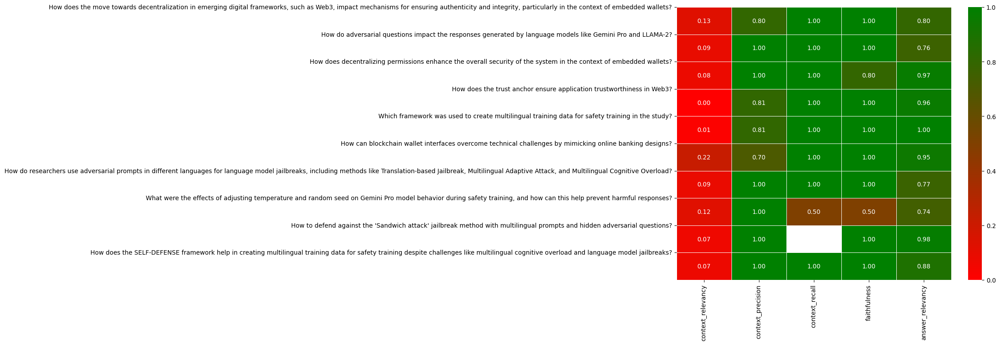

In [29]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# only use if not reading saved csv

# df = result.to_pandas()

heatmap_data = df[['context_relevancy', 'context_precision', 'context_recall', 'faithfulness', 'answer_relevancy']]

cmap = LinearSegmentedColormap.from_list('green_red', ['red', 'green'])

plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, annot=True, fmt=".2f", linewidths=.5, cmap=cmap)

plt.yticks(ticks=range(len(df['question'])), labels=df['question'], rotation=0)

plt.savefig('heatmap.png', dpi=300, bbox_inches='tight')
plt.show()
